In [157]:
#import libraries

import pandas as pd
import os

In [158]:
#GFB3 data

parent_directory = '/Users/varsharajb/Documents/FACAI/Matrix Model/Forest Growth Model Indiana/'
files = ['GFB3_Indiana/GFB3_US3_Indiana.csv']

for file in files:
    file_path = os.path.join(parent_directory, file)

    # Print column names
    print(f"\nColumns in file '{file}':")
    df = pd.read_csv(file_path, low_memory=False)
    print(df.columns.tolist())

    # number of columns
    num_columns = len(df.columns)
    print(f"\nNumber of columns: {num_columns}")

    # Print total number of rows
    num_rows = len(df)
    print(f"\nNumber of rows: {num_rows}")

    # Check for missing values (NaN) in each column
    na_columns = df.columns[df.isna().any()].tolist()

    if na_columns:
        print("\nColumns with missing values (NaN):")
        for col in na_columns:
            print(col)
    else:
        print("\nNo columns have missing values (NaN).")

print("\nDistinct Plots:", df['PlotID'].nunique())
print("\nDistinct Species:", df['Species'].nunique())


Columns in file 'GFB3_Indiana/GFB3_US3_Indiana.csv':
['PlotID', 'Latitude', 'Longitude', 'PA', 'Dmin', 'TreeID', 'Species', 'Status', 'DBH', 'YR', 'PrevDBH', 'PrevYR', 'note', 'Elevation_m', 'POM', 'PLT_CN', 'DSN_GFB3', 'DSN_GFB2', 'Orig_PlotID']

Number of columns: 19

Number of rows: 122294

Columns with missing values (NaN):
PA
Species
DBH
PrevDBH
note
Elevation_m

Distinct Plots: 4426

Distinct Species: 110


In [159]:
# Filtering the data based on conditions
df1 = df[
# filters rows where the Status, and Previous Year columns have missing values
(~df['Status'].isna()) &

# filters live trees with missing DBH information.
(~((df['Status'] == 0) & (df['DBH'].isna()))) &

# filters live trees with missing previous DBH information.                              
(~((df['Status'] == 0) & (df['PrevDBH'].isna()))) &

# filters dead trees with missing previous DBH information.                        
(~((df['Status'] == 1) & (df['PrevDBH'].isna()))) &

# filters new trees with missing previous DBH information.                        
(~((df['Status'] == 2) & (df['DBH'].isna()))) 
                        
]

# Printing the filtered data
print(df1.describe())

            Latitude      Longitude            PA          Dmin  \
count  122083.000000  122083.000000  98581.000000  1.220830e+05   
mean       39.311305     -86.314272      0.062788  2.540000e+00   
std         1.002525       0.725243      0.045439  4.440910e-16   
min        37.796056     -88.030000      0.000613  2.540000e+00   
25%        38.547536     -86.820444      0.067247  2.540000e+00   
50%        39.080000     -86.423894      0.067247  2.540000e+00   
75%        39.693917     -85.810000      0.067247  2.540000e+00   
max        41.758589     -84.818406      1.395498  2.540000e+00   

              Status            DBH             YR       PrevDBH  \
count  122083.000000  113630.000000  122083.000000  62670.000000   
mean        1.071492      25.329678    2005.992808     22.754777   
std         0.991725      16.052827       8.209333     13.768663   
min         0.000000       2.540000    1996.000000      2.540000   
25%         0.000000      14.478000    1997.000000     1

In [160]:
# Filter rows where DBH and PrevDBH are greater than or equal to 10 and not NaN

# Include NA values here because trees with status 1(dead) will not have DBH and with status 2(cut) not have PrevDBH

#df2 = df1[((df1['DBH'] >= 1) | (df1['PrevDBH'] >= 1))].copy()
df2 = df1[((df1['DBH'] >= 10) | (df1['DBH'].isna())) & ((df1['PrevDBH'] >= 10) | (df1['PrevDBH'].isna()))].copy()

# Calculate TPH (Trees Per Hectare), dYR (Year Difference), and dDBH (DBH Difference)
# TPH - Trees Per Hectare
df2.loc[:, 'TPH'] = 1 / df1['PA']
# dYR - difference between 'YR' (Year) and 'PrevYR' (Previous Year)
df2.loc[:, 'dYR'] = df1['YR'] - df1['PrevYR']
# dDBH - the difference between 'DBH' and 'PrevDBH'
df2.loc[:, 'dDBH'] = df1['DBH'] - df1['PrevDBH']

# Select specific columns
df2 = df2[['PlotID', 'DSN_GFB3', 'Latitude', 'Longitude', 'Status', 'Species', 'dDBH', 'DBH', 'PrevDBH', 'dYR', 'TPH', 'note']]

# Filter rows where Status is not NaN
df2 = df2[~df2['Status'].isna()]

# Print the resulting DataFrame
print(df2.describe())

max_value = df2['TPH'].max()
least = df1['PA'].min()
print(f"The maximum value in the PA column is: {least}")

            Latitude      Longitude         Status          dDBH  \
count  102425.000000  102425.000000  102425.000000  47094.000000   
mean       39.313845     -86.316739       1.046209      2.001403   
std         1.002418       0.724933       0.995647      1.723594   
min        37.796056     -88.030000       0.000000    -27.940000   
25%        38.560000     -86.823605       0.000000      0.762000   
50%        39.082832     -86.433599       1.000000      1.524000   
75%        39.696176     -85.810000       2.000000      2.794000   
max        41.758589     -84.818406       3.000000     42.164000   

                DBH       PrevDBH            dYR           TPH  
count  96089.000000  53430.000000  102425.000000  84527.000000  
mean      28.981005     25.806172       7.959287     17.635061  
std       14.743215     12.588291       3.032879     27.211498  
min       10.007600     10.160000       4.000000      0.716590  
25%       17.526000     16.256000       5.000000     14.870592

In [161]:
# Filter rows where Status is not equal to 2(new)
df3 = df2[df2['Status'] != 2]

# Group by 'Species' and calculate the count (number of occurece of each species)
df3 = df3.groupby('Species').size().reset_index(name='count_species')

# Sort df3 by 'count'
df3 = df3.sort_values(by='count_species')

# Calculate the mean count
mean_count = df3['count_species'].mean()

# Print the mean count
print('\nMean Species Occurence(count):',mean_count)

# Filter df3 where count is greater than the mean count
dfbig = df3[df3['count_species'] > mean_count]

print("\nDistinct Species with more number of Occurence(count):", dfbig['Species'].nunique())

# Filter rows where 'Species' is in 'dfbig' and 'Status' is not equal to 2
dfcluster = df2[df2['Species'].isin(dfbig['Species']) & (df2['Status'] != 2)]

# Group by 'Species' and calculate summary statistics
dfcluster = dfcluster.groupby('Species').agg(
    #Average Upgrowth(change in DBH) cm/year 
    avgDBH=('dDBH', lambda x: (x / dfcluster['dYR']).mean(skipna=True)),
    #Average percentage Mortality avgMpct = sum(Status / dYR) / n()) {average percentage (Status) change per year}
    avgMpct=('Status', lambda x: (x / dfcluster['dYR']).sum() / len(x))
).reset_index()

# Convert 'Species' column to categorical type
dfcluster['Species'] = pd.Categorical(dfcluster['Species'])

# Drop rows with NaN values in 'Species' column
dfcluster = dfcluster.dropna(subset=['Species'])

# Drop rows with any NaN values
dfcluster = dfcluster.dropna()

# Print the resulting DataFrame
print('\n',dfcluster)


Mean Species Occurence(count): 580.75

Distinct Species with more number of Occurence(count): 29

                     Species    avgDBH   avgMpct
0              Acer negundo  0.387341  0.049181
1               Acer rubrum  0.401174  0.018897
2          Acer saccharinum  0.538368  0.029859
3            Acer saccharum  0.294891  0.019678
4         Carya cordiformis  0.363967  0.017875
5              Carya glabra  0.284548  0.019724
6               Carya ovata  0.270442  0.014804
7       Celtis occidentalis  0.416171  0.018246
8         Fagus grandifolia  0.328617  0.017644
9        Fraxinus americana  0.366969  0.056365
10   Fraxinus pennsylvanica  0.387417  0.061796
11            Juglans nigra  0.416889  0.015584
12     Juniperus virginiana  0.206991  0.015217
13  Liquidambar styraciflua  0.365316  0.029418
14  Liriodendron tulipifera  0.585402  0.034536
15          Nyssa sylvatica  0.188796  0.014914
16            Pinus strobus  0.520490  0.023264
17    Platanus occidentalis  0.52563

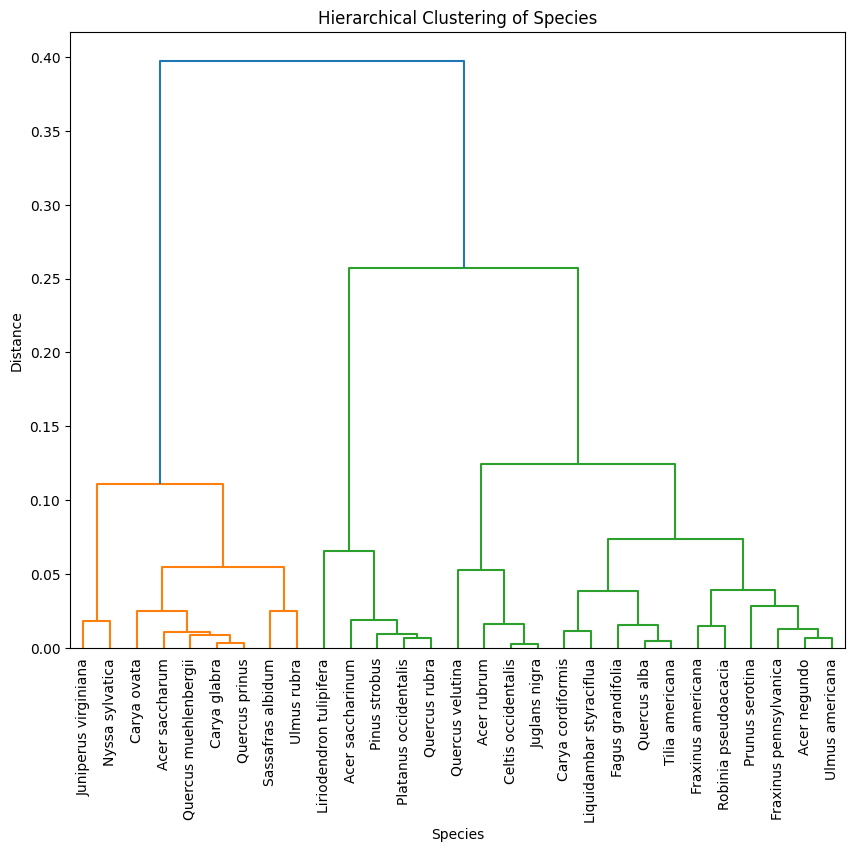

Species in Each Cluster:
Cluster 0: Acer negundo, Carya cordiformis, Fagus grandifolia, Fraxinus americana, Fraxinus pennsylvanica, Liquidambar styraciflua, Prunus serotina, Quercus alba, Robinia pseudoacacia, Tilia americana, Ulmus americana
Cluster 1: Acer rubrum, Celtis occidentalis, Juglans nigra, Quercus velutina
Cluster 2: Acer saccharinum, Liriodendron tulipifera, Pinus strobus, Platanus occidentalis, Quercus rubra
Cluster 3: Acer saccharum, Carya glabra, Carya ovata, Quercus muehlenbergii, Quercus prinus, Sassafras albidum, Ulmus rubra
Cluster 4: Juniperus virginiana, Nyssa sylvatica

Visual Representation of Clusters:


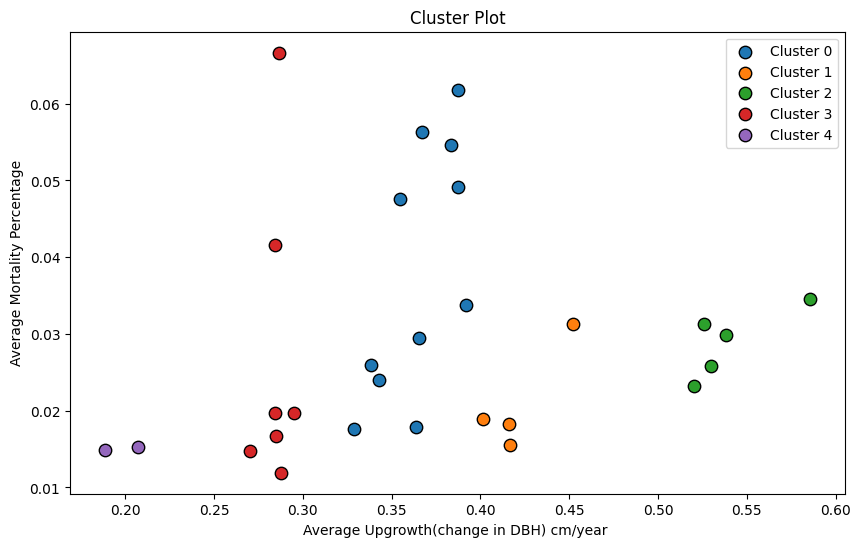

In [162]:
import pandas as pd
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram, cut_tree
import matplotlib.pyplot as plt

# Calculate Euclidean distance matrix
distance_matrix = pdist(dfcluster[['avgDBH', 'avgMpct']], metric='euclidean')

# Perform hierarchical clustering
hier_cl = linkage(distance_matrix, method='complete')

# Plot dendrogram for hierarchical clustering
plt.figure(figsize=(10, 8))
dendrogram(hier_cl, labels=dfcluster['Species'].tolist(), leaf_rotation=90)
plt.title('Hierarchical Clustering of Species')
plt.xlabel('Species')
plt.ylabel('Distance')
plt.show()

# Cut the dendrogram to form clusters
k = 5 # Number of clusters
clusters = cut_tree(hier_cl, n_clusters=k).flatten()

# Add 'cluster' column to dfcluster DataFrame
dfcluster['cluster'] = clusters

# Group by 'cluster' and aggregate 'Species' into a list for each cluster
cluster_species = dfcluster.groupby('cluster')['Species'].apply(list).reset_index(name='Species_List')

# Print the species in each cluster with a formatted output
print("Species in Each Cluster:")
print("=======================")
for index, row in cluster_species.iterrows():
    cluster_number = row["cluster"]
    species_list = ", ".join(row["Species_List"])
    print(f'Cluster {cluster_number}: {species_list}')

print("\nVisual Representation of Clusters:")
print("===================================")
# Plot clusters using scatter plot
plt.figure(figsize=(10, 6))
for cluster_num in cluster_species['cluster']:
    cluster_data = dfcluster[dfcluster['cluster'] == cluster_num]
    plt.scatter(cluster_data['avgDBH'], cluster_data['avgMpct'], label=f'Cluster {cluster_num}', marker='o', edgecolors='black', s=80)

plt.xlabel('Average Upgrowth(change in DBH) cm/year ')
plt.ylabel('Average Mortality Percentage')
plt.title('Cluster Plot')
plt.legend()
plt.show()

In [163]:
import pandas as pd
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, cut_tree
import matplotlib.pyplot as plt
from pandas.plotting import table
from IPython.display import display, HTML

# Assuming dfcluster, hier_cl, and cluster_species are defined as in your code

# Calculate Euclidean distance matrix
distance_matrix = pdist(dfcluster[['avgDBH', 'avgMpct']], metric='euclidean')

# Perform hierarchical clustering
hier_cl = linkage(distance_matrix, method='complete')

# Cut the dendrogram to form clusters
k = 5  # Number of clusters
clusters = cut_tree(hier_cl, n_clusters=k).flatten()

# Add 'cluster' column to dfcluster DataFrame
dfcluster['cluster'] = clusters

# Group by 'cluster' and aggregate 'Species' into a list for each cluster
cluster_species = dfcluster.groupby('cluster')['Species'].apply(list).reset_index(name='Species_List')

# Create a table for species in each cluster
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust figsize for width
ax.axis('off')  # Hide axis

# Create the table
tbl = table(ax, cluster_species, loc='center')

# Set cell text alignment to left
for key, cell in tbl.get_celld().items():
    cell.set_text_props(fontsize=10, ha='left')  # Set text properties and alignment

# Format the table
tbl.auto_set_font_size(False)
tbl.scale(1, 1)  # Adjust scaling for width and height

# Display the table
display(HTML(cluster_species.to_html(index=False)))

# Save the table as an image
plt.savefig('cluster_species_table.png', bbox_inches='tight')  # Save as image
plt.close()

# Print confirmation message
print("Table of Species in Each Cluster Saved as 'cluster_species_table.png'")


cluster,Species_List
0,"[Acer negundo, Carya cordiformis, Fagus grandifolia, Fraxinus americana, Fraxinus pennsylvanica, Liquidambar styraciflua, Prunus serotina, Quercus alba, Robinia pseudoacacia, Tilia americana, Ulmus americana]"
1,"[Acer rubrum, Celtis occidentalis, Juglans nigra, Quercus velutina]"
2,"[Acer saccharinum, Liriodendron tulipifera, Pinus strobus, Platanus occidentalis, Quercus rubra]"
3,"[Acer saccharum, Carya glabra, Carya ovata, Quercus muehlenbergii, Quercus prinus, Sassafras albidum, Ulmus rubra]"
4,"[Juniperus virginiana, Nyssa sylvatica]"


Table of Species in Each Cluster Saved as 'cluster_species_table.png'


In [164]:
#  df2 (PlotID, DSN_GFB3, Latitude, Longitude, Status, Species, dDBH, DBH, PrevDBH, dYR, TPH, note) 
#  dfcluster (Species, avgDBH, avgMpct, cluster)

# Perform left join between df2 and columns (1st and 4th columns) from dfcluster based on the 'Species' column.
dfsp = df2.merge(dfcluster.iloc[:, [0, 3]], on='Species', how='left')

# Create SPCD column, If 'cluster' value is NaN: it returns 1, for already existing clusters it adds 2 and converts the result to a factor. it returns 1 ; sp total 6 distinct SPCD
dfsp['SPCD'] = dfsp['cluster'].apply(lambda x: 1 if pd.isna(x) else int(x) + 2).astype('category') 

# Print the first few rows to check the result 
# dfsp --> (PlotID, DSN_GFB3, Latitude, Longitude, Status, Species, dDBH, DBH, PrevDBH, dYR, TPH, note, cluster, SPCD )
print("\ndfsp\n",dfsp.head())

# Replace NaN values in 'Species' column with empty strings
dfsp['Species'] = dfsp['Species'].fillna('')

# Group by SPCD and concatenate Species
species_groups = dfsp.groupby('SPCD', observed=True)['Species'].agg(', '.join).reset_index(name='Group')

# Print the species_groups DataFrame
print("\nSpecies Groups\n", species_groups)


dfsp
                 PlotID DSN_GFB3   Latitude  Longitude  Status  \
0  103_18_3_20041_2018      US3  41.230087 -84.913152       0   
1  103_18_3_20041_2018      US3  41.230087 -84.913152       0   
2  103_18_3_20041_2018      US3  41.230087 -84.913152       0   
3  103_18_3_20041_2018      US3  41.230087 -84.913152       1   
4  103_18_3_20041_2018      US3  41.230087 -84.913152       0   

           Species   dDBH     DBH  PrevDBH  dYR        TPH note  cluster SPCD  
0      Carya ovata  0.508  14.478   13.970    7  14.870592  NaN      3.0    5  
1  Ulmus americana  2.286  34.036   31.750    7  14.870592  NaN      0.0    2  
2  Ulmus americana  3.810  29.464   25.654    7  14.870592  NaN      0.0    2  
3  Ulmus americana    NaN     NaN   20.574    7  14.870592  NaN      0.0    2  
4  Tilia americana  0.762  17.780   17.018    7  14.870592  NaN      0.0    2  

Species Groups
   SPCD                                              Group
0    1  Ostrya virginiana, Ulmus pumila, Ulmus 

In [165]:
# Filter out rows where Status is not equal to 2 (2 = new tree)
filtered_dfsp = dfsp[dfsp['Status'] != 2]

# Group by SPCD and calculate average values using apply and lambda
group_avgs = filtered_dfsp.groupby('SPCD', observed=True).apply(lambda group:
    pd.Series({
        'avgdD': group['dDBH'].mean() / group['dYR'].mean(skipna=True),
        'avgMpct': group['Status'].sum() / group['dYR'].sum() / len(group)
    })
).reset_index()

# Print the group_avgs DataFrame
print("\ngroup_avgs\n", group_avgs)

# Select specific columns
dfsp = dfsp[['PlotID', 'Latitude', 'Longitude', 'dYR', 'Status', 'dDBH', 'DBH', 'PrevDBH', 'TPH', 'SPCD']]

# Print summary statistics of dfsp
print("\ndfsp\n", dfsp.describe())

# Count the number of distinct values in the 'SPCD' column
n_distinct = dfsp['SPCD'].nunique()


print("\nNumber of distinct values in SPCD:", n_distinct)


group_avgs
   SPCD     avgdD   avgMpct
0    1  0.362705  0.000007
1    2  0.359897  0.000002
2    3  0.417615  0.000003
3    4  0.552576  0.000004
4    5  0.286451  0.000002
5    6  0.198693  0.000006

dfsp
             Latitude      Longitude            dYR         Status  \
count  102425.000000  102425.000000  102425.000000  102425.000000   
mean       39.313845     -86.316739       7.959287       1.046209   
std         1.002418       0.724933       3.032879       0.995647   
min        37.796056     -88.030000       4.000000       0.000000   
25%        38.560000     -86.823605       5.000000       0.000000   
50%        39.082832     -86.433599       6.000000       1.000000   
75%        39.696176     -85.810000      11.000000       2.000000   
max        41.758589     -84.818406      17.000000       3.000000   

               dDBH           DBH       PrevDBH           TPH  
count  47094.000000  96089.000000  53430.000000  84527.000000  
mean       2.001403     28.981005     25.

In [166]:
from tabulate import tabulate
import pandas as pd

# Define the bin edges for DBH grouping
bins = list(range(10, 60, 5)) + [float('inf')]

# Define the labels for the groups based on the number of bins (one less label than bins)
labels = [f'{i + 1}' for i in range(len(bins) - 1)]

# Print the bins and labels
print("Bins:", bins)
print("Labels:", labels)

# Create new columns based on DBH and PrevBDH grouping
dfsp['DGP'] = pd.cut(dfsp['DBH'], bins=bins, labels=labels, right=False)
dfsp['PrevDGP'] = pd.cut(dfsp['PrevDBH'], bins=bins, labels=labels, right=False)

# Assuming dfsp is your DataFrame
num_na_dbh = dfsp['DBH'].isna().sum()
num_na_prevdbh = dfsp['PrevDBH'].isna().sum()

print(f"Number of NaN values in 'DBH': {num_na_dbh}")
print(f"Number of NaN values in 'PrevDBH': {num_na_prevdbh}")

# Handle values above 55 and NaN values separately and assign to Group 10
dfsp.loc[(dfsp['DBH'] >= 60) & (dfsp['DGP'].isna()), 'DGP'] = '10'
dfsp.loc[(dfsp['PrevDBH'] >= 60) & (dfsp['PrevDGP'].isna()), 'PrevDGP'] = '10'

# Display the DataFrame to check the new columns
print(dfsp.head())

# Count occurrences of each group for DBHGP and PDBHGP
DGP_counts = dfsp['DGP'].value_counts().sort_index()
PrevDGP_counts = dfsp['PrevDGP'].value_counts().sort_index()

table_data = []
total_dbh_count = 0
total_pdbh_count = 0

for i, (start, end) in enumerate(zip(bins[:-1], bins[1:])):
    label = labels[i]
    dbh_count = DGP_counts[label] if label in DGP_counts else 0
    pdbh_count = PrevDGP_counts[label] if label in PrevDGP_counts else 0
    total_dbh_count += dbh_count
    total_pdbh_count += pdbh_count
    table_data.append([label, f'({start}, {end})', dbh_count, pdbh_count])

# Add a row for total counts
table_data.append(['Total', '', total_dbh_count, total_pdbh_count])

# Print the table
print(tabulate(table_data, headers=['Group Name', 'Range', 'DBH Count', 'PrevDBH Count'], tablefmt='grid'))

Bins: [10, 15, 20, 25, 30, 35, 40, 45, 50, 55, inf]
Labels: ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
Number of NaN values in 'DBH': 6336
Number of NaN values in 'PrevDBH': 48995
                PlotID   Latitude  Longitude  dYR  Status   dDBH     DBH  \
0  103_18_3_20041_2018  41.230087 -84.913152    7       0  0.508  14.478   
1  103_18_3_20041_2018  41.230087 -84.913152    7       0  2.286  34.036   
2  103_18_3_20041_2018  41.230087 -84.913152    7       0  3.810  29.464   
3  103_18_3_20041_2018  41.230087 -84.913152    7       1    NaN     NaN   
4  103_18_3_20041_2018  41.230087 -84.913152    7       0  0.762  17.780   

   PrevDBH        TPH SPCD  DGP PrevDGP  
0   13.970  14.870592    5    1       1  
1   31.750  14.870592    2    5       5  
2   25.654  14.870592    2    4       4  
3   20.574  14.870592    2  NaN       3  
4   17.018  14.870592    2    2       2  
+--------------+-----------+-------------+-----------------+
| Group Name   | Range     |   DBH Count 

In [167]:
import pandas as pd
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, cut_tree
import matplotlib.pyplot as plt
from pandas.plotting import table
from IPython.display import display, HTML

# Assuming dfcluster, hier_cl, and cluster_species are defined as in your code

# Calculate Euclidean distance matrix
distance_matrix = pdist(dfcluster[['avgDBH', 'avgMpct']], metric='euclidean')

# Perform hierarchical clustering
hier_cl = linkage(distance_matrix, method='complete')

# Cut the dendrogram to form clusters
k = 5  # Number of clusters
clusters = cut_tree(hier_cl, n_clusters=k).flatten()

# Add 'cluster' column to dfcluster DataFrame
dfcluster['cluster'] = clusters

# Group by 'cluster' and aggregate 'Species' into a list for each cluster
cluster_species = dfcluster.groupby('cluster')['Species'].apply(list).reset_index(name='Species_List')

# Create a table for species in each cluster
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust figsize for width
ax.axis('off')  # Hide axis

# Create the table
tbl = table(ax, cluster_species, loc='right')

# Set cell text alignment to left
for key, cell in tbl.get_celld().items():
    cell.set_text_props(fontsize=10, ha='left')  # Set text properties and alignment

# Format the table
tbl.auto_set_font_size(False)
tbl.scale(1, 1)  # Adjust scaling for width and height

# Display the table
display(HTML(cluster_species.to_html(index=False)))

# Save the table as an image
plt.savefig('cluster_species_table.png', bbox_inches='tight')  # Save as image
plt.close()

# Print confirmation message
print("Table of Species in Each Cluster Saved as 'cluster_species_table.png'")


cluster,Species_List
0,"[Acer negundo, Carya cordiformis, Fagus grandifolia, Fraxinus americana, Fraxinus pennsylvanica, Liquidambar styraciflua, Prunus serotina, Quercus alba, Robinia pseudoacacia, Tilia americana, Ulmus americana]"
1,"[Acer rubrum, Celtis occidentalis, Juglans nigra, Quercus velutina]"
2,"[Acer saccharinum, Liriodendron tulipifera, Pinus strobus, Platanus occidentalis, Quercus rubra]"
3,"[Acer saccharum, Carya glabra, Carya ovata, Quercus muehlenbergii, Quercus prinus, Sassafras albidum, Ulmus rubra]"
4,"[Juniperus virginiana, Nyssa sylvatica]"


Table of Species in Each Cluster Saved as 'cluster_species_table.png'


In [168]:
import pandas as pd
import numpy as np
import warnings

#'newN' number of trees per hectare with status = 2, if status = 1 assign 0
#'oldN'  number of trees per hectare with status = 1, if status = 2 assign 0
dfsp['newN'] = dfsp.apply(lambda row: 0 if row['Status'] == 1 else row['TPH'], axis=1)
dfsp['oldN'] = dfsp.apply(lambda row: 0 if row['Status'] == 2 else row['TPH'], axis=1)

# Group by 'PlotID'
grouped_df = dfsp.groupby('PlotID')

# Calculate new columns within each group
dffinal = grouped_df.apply(lambda x: pd.Series({
    'PrevB': (3.14159 * x['PrevDBH'] ** 2 / 40000 * x['TPH']).sum(),
    #sum of 'oldN' within each group.
    'PrevN': x['oldN'].sum(),
    'B': (3.14159 * x['DBH'] ** 2 / 40000 * x['TPH']).sum(),
    #sum of 'newN' within each group.
    'N': x['newN'].sum(),
    #'Hs' is the number of unique values in the 'SPCD' column within each group (converted to a factor).
    'Hs': len(x['SPCD'].unique()),
    #'Hd' is the number of unique values in the 'DGP' column within each group (converted to a factor).
    'Hd': len(x['DGP'].unique())
})).reset_index()

# Add all columns from dfsp to dffinal
dffinal = pd.merge(dffinal, dfsp, on='PlotID')

print(dffinal['SPCD'].unique())
print(dffinal['DGP'].unique())

print(dffinal)

# Loop through each column in dffinal and print its distinct values
for column in dffinal.columns:
    unique_values = dffinal[column].nunique()
    print(f"\nDistinct values of '{column}': {unique_values}")

[3, 5, 6, 2, 4, 1]
Categories (6, int64): [1, 2, 3, 4, 5, 6]
['4', '7', '6', '1', '9', ..., '2', '5', '8', '10', NaN]
Length: 11
Categories (10, object): ['1' < '2' < '3' < '4' ... '7' < '8' < '9' < '10']
                     PlotID  PrevB  PrevN          B           N   Hs    Hd  \
0       103_18_101_101_1997    0.0    0.0  21.957060  591.876409  6.0  10.0   
1       103_18_101_101_1997    0.0    0.0  21.957060  591.876409  6.0  10.0   
2       103_18_101_101_1997    0.0    0.0  21.957060  591.876409  6.0  10.0   
3       103_18_101_101_1997    0.0    0.0  21.957060  591.876409  6.0  10.0   
4       103_18_101_101_1997    0.0    0.0  21.957060  591.876409  6.0  10.0   
...                     ...    ...    ...        ...         ...  ...   ...   
102420     103_18_9_54_1998    0.0    0.0  25.007071  330.273860  5.0   8.0   
102421     103_18_9_54_1998    0.0    0.0  25.007071  330.273860  5.0   8.0   
102422     103_18_9_54_1998    0.0    0.0  25.007071  330.273860  5.0   8.0   
10242

In [169]:
# Create Separate Datasets for M(Mortality), U(Upgrowth), R(Recruitment) models 

# Filter rows where Status is 0 (Upgrowth)
dfup = dffinal[dffinal['Status'] == 0].copy()
dfup.loc[:, 'dDBH'] = dfup['dDBH'] / dfup['dYR']
dfup = dfup[['PlotID', 'Latitude', 'Longitude', 'dDBH', 'PrevDBH', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']].dropna()

# Print the first few rows of dfup to verify
print(dfup)

# Filter rows where Status is not equal to 2 (Mortality)
dfmort = dffinal[dffinal['Status'] != 2].copy()
dfmort.loc[:, 'M'] = dfmort['Status'] / dfmort['dYR']
dfmort = dfmort[['PlotID', 'Latitude', 'Longitude', 'M', 'PrevDBH', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']].dropna()

# Print the first few rows of dfmort to verify
print(dfmort)

dfrec = (dffinal
          #rec = TPH when Status = 2, otherwise 0
         .assign(rec=lambda x: np.where(x['Status'] == 2, x['TPH'], 0))
         .groupby(['PlotID', 'SPCD'], observed=False)
         .apply(lambda group: group.assign(R=group['rec'].sum()))
         .reset_index(drop=True)
         .drop_duplicates(['PlotID', 'Latitude', 'Longitude', 'R', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd'])
         .dropna()
         )
dfrec = dfrec[['PlotID', 'Latitude', 'Longitude', 'R', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']].dropna()

# Print the first few rows of dfrec to verify
print(dfrec)

                       PlotID   Latitude  Longitude      dDBH  PrevDBH SPCD  \
46      103_18_101_10206_2010  38.611813 -86.824362  0.304800   24.384    2   
47      103_18_101_10206_2010  38.611813 -86.824362  0.660400   32.258    3   
49      103_18_101_10206_2010  38.611813 -86.824362  0.203200   48.768    2   
50      103_18_101_10206_2010  38.611813 -86.824362  0.355600   21.082    2   
51      103_18_101_10206_2010  38.611813 -86.824362  0.558800   53.848    4   
...                       ...        ...        ...       ...      ...  ...   
102338    103_18_9_20051_2019  40.460312 -85.343311  0.072571   22.860    3   
102339    103_18_9_20051_2019  40.460312 -85.343311  0.362857   26.162    3   
102340    103_18_9_20051_2019  40.460312 -85.343311  0.290286   19.304    1   
102342    103_18_9_20051_2019  40.460312 -85.343311  0.580571   20.320    5   
102343    103_18_9_20051_2019  40.460312 -85.343311  0.290286   22.860    1   

           PrevB       PrevN   Hs    Hd  
46      2

In [170]:
import pandas as pd

# Assuming dffinal is your DataFrame
T1 = dffinal[~dffinal['PrevDGP'].isna()].copy()  # Filter rows where PrevDGP is not NA and create a copy
T1['SPCD'] = T1['SPCD'].astype(str).str.zfill(2)  # Zero-pad to 2 digits
T1['PrevDGP'] = T1['PrevDGP'].astype(str).str.zfill(2)  # Zero-pad to 2 digits
T1['S_D'] = 'S' + T1['SPCD'] + '_D' + T1['PrevDGP']  # Create S_D column
T1 = T1.sort_values(by=['PlotID', 'S_D'])  # Sort by PlotID and S_D

# Group by PlotID and S_D, aggregate metrics, and reset index
plotsT1 = T1.groupby(['PlotID', 'S_D']).agg(TPH=('TPH', 'sum'),
                                             dYR=('dYR', 'mean'),
                                             PrevB=('PrevB', 'mean'),
                                             PrevN=('PrevN', 'mean'),
                                             Latitude=('Latitude', 'first'),
                                             Longitude=('Longitude', 'first')).fillna(0).reset_index()

# Pivot table on PlotID and S_D, using TPH as values and retaining specified columns
plotsT1 = pd.pivot_table(plotsT1, index=['PlotID', 'dYR', 'PrevB', 'PrevN', 'Latitude', 'Longitude'], columns='S_D', values='TPH', aggfunc='sum', fill_value=0).reset_index()

# Merge with the original DataFrame to retain the desired columns and group by PlotID
#plotsT1 = plotsT1.merge(T1[['PlotID', 'dYR', 'PrevB', 'PrevN', 'Latitude', 'Longitude']].groupby('PlotID').first(), on='PlotID', how='left')

print(plotsT1)


S_D                  PlotID  dYR      PrevB       PrevN   Latitude  Longitude  \
0     103_18_101_10206_2010  5.0  27.143150  297.411833  38.611813 -86.824362   
1     103_18_101_10206_2016  6.0  28.933098  297.411833  38.611813 -86.824362   
2     103_18_101_10207_2011  5.0  23.627605  297.411833  38.645143 -86.798495   
3     103_18_101_10207_2017  6.0  24.192883  267.670650  38.645143 -86.798495   
4     103_18_101_10208_2012  5.0  30.488404  133.835325  38.891847 -86.801980   
...                     ...  ...        ...         ...        ...        ...   
3550    103_18_9_20042_2021  7.0   8.509389  133.835325  40.420980 -85.419809   
3551    103_18_9_20051_2007  5.0  11.467492  282.541242  40.460312 -85.343311   
3552    103_18_9_20051_2012  5.0  14.977160  342.023608  40.460312 -85.343311   
3553    103_18_9_20051_2012  5.0  14.977160  342.023608  40.460312 -85.343311   
3554    103_18_9_20051_2019  7.0  15.647100  312.282425  40.460312 -85.343311   

S_D   S01_D01    S01_D02   

In [171]:
import pandas as pd

# Assuming dffinal is your DataFrame
T2 = dffinal[~dffinal['DGP'].isna()].copy()  # Filter rows where PrevDGP is not NA and create a copy
T2['SPCD'] = T2['SPCD'].astype(str).str.zfill(2)  # Zero-pad to 2 digits
T2['DGP'] = T2['DGP'].astype(str).str.zfill(2)  # Zero-pad to 2 digits
T2['S_D'] = 'S' + T2['SPCD'] + '_D' + T1['PrevDGP']  # Create S_D column
T2 = T2.sort_values(by=['PlotID', 'S_D'])  # Sort by PlotID and S_D

# Group by PlotID and S_D, aggregate metrics, and reset index
plotsT2 = T2.groupby(['PlotID', 'S_D']).agg(TPH=('TPH', 'sum'),
                                             dYR=('dYR', 'mean'),
                                             B=('B', 'mean'),
                                             N=('N', 'mean'),
                                             Latitude=('Latitude', 'first'),
                                             Longitude=('Longitude', 'first')).fillna(0).reset_index()

# Pivot table on PlotID and S_D, using TPH as values and retaining specified columns
plotsT2 = pd.pivot_table(plotsT2, index=['PlotID', 'dYR', 'B', 'N', 'Latitude', 'Longitude'], columns='S_D', values='TPH', aggfunc='sum', fill_value=0).reset_index()

# Merge with the original DataFrame to retain the desired columns and group by PlotID
#plotsT2 = plotsT2.merge(T2[['PlotID', 'dYR', 'PrevB', 'PrevN', 'Latitude', 'Longitude']].groupby('PlotID').first(), on='PlotID', how='left')

print(plotsT2)

S_D                  PlotID  dYR          B           N   Latitude  Longitude  \
0     103_18_101_10206_2010  5.0  28.933098  297.411833  38.611813 -86.824362   
1     103_18_101_10206_2016  6.0  28.019399  312.282425  38.611813 -86.824362   
2     103_18_101_10207_2011  5.0  24.192883  267.670650  38.645143 -86.798495   
3     103_18_101_10207_2017  6.0  23.796088  237.929467  38.645143 -86.798495   
4     103_18_101_10208_2012  5.0  23.383847  118.964733  38.891847 -86.801980   
...                     ...  ...        ...         ...        ...        ...   
3418    103_18_9_20042_2021  7.0  10.477012  133.835325  40.420980 -85.419809   
3419    103_18_9_20051_2007  5.0  14.977160  342.023608  40.460312 -85.343311   
3420    103_18_9_20051_2007  5.0  14.977160  342.023608  40.460312 -85.343311   
3421    103_18_9_20051_2012  5.0  15.647100  312.282425  40.460312 -85.343311   
3422    103_18_9_20051_2019  7.0  15.691255  267.670650  40.460312 -85.343311   

S_D   S01_D01    S01_D02   

In [172]:
# Write plotsT1 to CSV without row names
plotsT1.to_csv('plotsT1.csv', index=False)

# Write plotsT2 to CSV without row names
plotsT2.to_csv('plotsT2.csv', index=False)

# Write dfrec to CSV without row names
dfrec.to_csv('recruitment.csv', index=False)

# Write dfmort to CSV without row names
dfmort.to_csv('mortality.csv', index=False)

# Write dfup to CSV without row names
dfup.to_csv('upgrowth.csv', index=False)

# Write species_groups to CSV without row names
species_groups.to_csv('species_groups.csv', index=False)

# Write group_avgs to CSV without row names
group_avgs.to_csv('SCPD_avg_dynamics.csv', index=False)


In [173]:
# Creating folds for cross-validation (CV)
plots = plotsT1[['PlotID']].drop_duplicates()
plots['Group1'] = np.random.randint(1, 11, size=len(plots))
plots['Group2'] = np.random.randint(1, 11, size=len(plots))
plots['Group3'] = np.random.randint(1, 11, size=len(plots))
plots['Group4'] = np.random.randint(1, 11, size=len(plots))
plots['Group5'] = np.random.randint(1, 11, size=len(plots))

plots.to_csv('plot_groups.csv', index=False)

# Create CSV of Plot Coords
coords = df2[df2['PlotID'].isin(plotsT1['PlotID'])][['PlotID', 'Latitude', 'Longitude']].drop_duplicates()

coords.to_csv('plot_coords.csv', index=False)

# Filter and write filtered data to CSV
df_shar = df[df['PlotID'].isin(df2['PlotID'])]

df_shar.to_csv('GFB3_US3_Indiana_filtered.csv', index=False)

In [174]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import time
from joblib import Parallel, delayed
import math
#from ranger import Ranger 

# Define the project_plot function
def project_plot(plt_vec):

    #row_df = pd.DataFrame([row], columns=t1.columns)

    # Define the DBH array
    DBH = np.arange(10, 60, 5) + 2.5
    DBH[9] = 70 
    #20th position [11.25 13.75 16.25 18.75 21.25 23.75 26.25 28.75 31.25 33.75 36.25 38.75 41.25 43.75 46.25 48.75 51.25 53.75 56.25 80.0  ]
    pred_df = plt_vec.copy
    # Gather columns 4 to 64 into 'S_D' and 'TPH', retaining other columns as is
    pred_df = pd.melt(plt_vec, id_vars=['PlotID', 'dYR', 'PrevB', 'PrevN'], 
                          value_vars=plt_vec.columns[4:64], var_name='S_D', value_name='TPH')
   
    # Extract SPCD and DGP from 'S_D'
    pred_df['SPCD'] = pred_df['S_D'].str[1:3].astype(int).astype('category')
    pred_df['DGP'] = pred_df['S_D'].str[5:7].astype(int)

    # Calculate PrevDBH based on DGP ('DGP' is used as an index to extract the corresponding element from the DBH vector.)
    pred_df['PrevDBH'] = pred_df['DGP'].apply(lambda x: DBH[x-1] if x >= 1 and x <= len(DBH) else np.nan)

    # Calculate Hs and Hd
    #number of distinct elements in 'SPCD' where 'TPH' is greater than 0, converts it to a factor, and stores it in 'Hs'.
    pred_df['Hs'] = pred_df.loc[pred_df['TPH'] > 0, 'SPCD'].nunique()
    #number of distinct elements in 'DGP' where 'TPH' is greater than 0, converts it to a factor, and stores it in 'Hd'.
    pred_df['Hd'] = pred_df.loc[pred_df['TPH'] > 0, 'DGP'].nunique()

    # Group by 'PlotID' and calculate 'PrevB' and 'PrevN'
    pred_df['PrevB'] = pred_df.groupby('PlotID').apply(lambda group: np.sum(group['TPH'] * (np.take(DBH, group['DGP'] - 1)**2 / 40000) * 3.14159)).reset_index(drop=True)
    
    pred_df['PrevN'] = pred_df.groupby('PlotID')['TPH'].apply(lambda group: group.sum())

    # Assuming m, u, r are already trained RandomForestRegressor models
    #for i in range(1, int(plt_vec['dYR'].values[0])): 
    #for i in range(1, int(plt_vec['dYR'].astype(int).iloc[0])):

    print('Column Names', pred_df.columns)  # Print column names

    # Assuming m, u, r are trained models
    pred_df['mort'] = m.predict(pred_df[['PrevDBH', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']])
    pred_df['up'] = u.predict(pred_df[['PrevDBH', 'SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']]) / 5
    pred_df['rec'] = r.predict(pred_df[['SPCD', 'PrevB', 'PrevN', 'Hs', 'Hd']])

    # 2.5 to 'rec' if 'rec' is equal to 1, and  0 if 'rec' is not equal to 1.
    pred_df['rec'] = np.where(pred_df['rec'] == 1, 1.25, 0)
    # 'up' is set to 0 if 'DGP' is greater than or equal to 10 or 'up' is less than 0.
    pred_df['up'] = np.where((pred_df['DGP'] >= 10) | (pred_df['up'] < 0), 0, pred_df['up'])
    #'rec' is set to 0 if 'DGP' is not equal to 1.
    pred_df['rec'] = np.where(pred_df['DGP'] != 1, 0, pred_df['rec'])
    #'TPH' is updated based on the values of 'mort' and 'up' along with the original 'TPH' values.
    pred_df['TPH'] = pred_df['TPH'] * (1 - pred_df['mort'] - pred_df['up'])
        
    # Group by 'SPCD' and calculate 'added' column
    #pred_df['added'] = pred_df.groupby('SPCD', observed=False).apply(lambda group: group['rec'] if (group['DGP'] == 1).all()
                                                   # else group['up'] * group['TPH'].shift(1)).reset_index(drop=True)
    

    # Assuming pred_df is your DataFrame
    pred_df.sort_values(by='DGP', inplace=True)  # Sort DataFrame by 'DGP' column

    # Group by 'SPCD' and calculate 'added' based on conditions
    pred_df['added'] = pred_df.groupby('SPCD', observed=False).apply(
        lambda group: group['rec'] if (group['DGP'] == 1).all() else group['up'] * group['TPH'].shift(1)
    ).reset_index(drop=True)

    # Reset index after sorting and grouping
    pred_df.reset_index(drop=True, inplace=True)

    #NaN values with 0
    pred_df['added'].fillna(0, inplace=True)

    # Continue with further operations
    #pred_df['TPH'] = pred_df['TPH'] + pred_df['added']
    pred_df['TPH'] = pred_df['TPH']

    # Calculate Hs and Hd
    pred_df['Hs'] = pred_df.loc[pred_df['TPH'] > 0, 'SPCD'].nunique()
    pred_df['Hd'] = pred_df.loc[pred_df['TPH'] > 0, 'DGP'].nunique()

    pred_df['PrevB'] = np.sum(pred_df['TPH'] * (np.take(DBH, pred_df['DGP'] - 1)**2 / 40000) * 3.14159)
    pred_df['PrevN'] = pred_df['TPH'].sum()

    # Assuming pred_df is your DataFrame
    pred_df = pred_df[['PlotID', 'dYR', 'PrevB', 'PrevN', 'S_D', 'TPH']]
    pred_df = pred_df.rename(columns={'PrevB': 'B', 'PrevN': 'N'})

    # Convert 'dYR', 'B', and 'N' to appropriate data types if needed
    pred_df[['dYR', 'B', 'N']] = pred_df[['dYR', 'B', 'N']].astype(str)

    # Use pivot_table with aggfunc='sum' to pivot and aggregate by sum
    pred_df = pd.pivot_table(pred_df, index=['PlotID', 'dYR', 'B', 'N'], columns='S_D', values='TPH', aggfunc='sum', fill_value=0).reset_index()
    
    print('\nfinal df is \n',pred_df)
    return pred_df

all_predictions_list = []

np.random.seed(123)

for i in range(1, 5):
    for j in range(1, 10):
        # Load and filter data
        plot_groups = pd.read_csv('plot_groups.csv')
        testplots = plot_groups[plot_groups[f'Group{i}'] == j]

        # Read the CSV file 'recruitment.csv' into a DataFrame called trainr
        trainr = pd.read_csv('recruitment.csv')

        # Filter rows where PlotID is not in testplots$PlotID, drop 'PlotID' column,
        # convert columns to factors (assuming SPCD, Hs, Hd are categorical), and remove specified columns        
        trainr = (trainr[~trainr['PlotID'].isin(testplots['PlotID'])].drop(columns=['PlotID', 'Latitude', 'Longitude']).astype({'SPCD': 'category', 'Hs': 'category', 'Hd': 'category'}))

        # Read the CSV file 'upgrowth.csv' into a DataFrame called trainu
        trainu = pd.read_csv('upgrowth.csv')

        # Filter rows where PlotID is not in testplots$PlotID, drop 'PlotID' column,
  
        trainu = (trainu[~trainu['PlotID'].isin(testplots['PlotID'])].drop(columns=['PlotID']).astype({'SPCD': 'category', 'Hs': 'category', 'Hd': 'category'}))

        # Calculate the 99.99th percentile of the non-NaN values in 'dDBH'
        non_nan_dDBH = trainu['dDBH'].dropna()
        quantile_9999 = non_nan_dDBH.quantile(0.9999, interpolation='linear')

        # Filter rows where 'dDBH' is within the calculated quantile range, drop specified columns
        trainu = (trainu[(trainu['dDBH'] >= 0) & (trainu['dDBH'] <= quantile_9999)].drop(columns=['Latitude', 'Longitude']))

        # Read the CSV file 'mortality.csv' into a DataFrame called trainm
        trainm = pd.read_csv('mortality.csv')

        # Filter rows where PlotID is not in testplots$PlotID, drop 'PlotID' column,
        # convert columns to factors (assuming SPCD, Hs, Hd are categorical)
        trainm = (trainm[~trainm['PlotID'].isin(testplots['PlotID'])].drop(columns=['PlotID','Latitude', 'Longitude',]).astype({'SPCD': 'category', 'Hs': 'category', 'Hd': 'category'}))

        # Read the CSV file 'plotsT1.csv' into a DataFrame called t1
        t1 = pd.read_csv('plotsT1.csv')

        # Filter rows where PlotID is in testplots$PlotID, drop 'Latitude' and 'Longitude' columns
        t1 = t1[t1['PlotID'].isin(testplots['PlotID'])].drop(columns=['Latitude', 'Longitude'])

        # Read the CSV file 'plotsT2.csv' into a DataFrame called t2
        t2 = pd.read_csv('plotsT2.csv')

        # Filter rows where PlotID is in testplots$PlotID, drop 'Latitude' and 'Longitude' columns
        t2 = t2[t2['PlotID'].isin(testplots['PlotID'])].drop(columns=['Latitude', 'Longitude'])

        # Create RandomForestClassifier for 'M', 'dDBH' and 'R' prediction
        
        m = RandomForestRegressor(n_estimators=100, max_features=3, criterion='squared_error')
        u = RandomForestRegressor(n_estimators=100, max_features=3, criterion='squared_error')
        r = RandomForestRegressor(n_estimators=100, max_features=3, criterion='squared_error')

        # Fit the model using training data
        m.fit(trainm.drop(columns=['M']), trainm['M'])
        u.fit(trainu.drop(columns=['dDBH']), trainu['dDBH'])
        r.fit(trainr.drop(columns=['R']), trainr['R'])

        # Initialize an empty list to store results
        predictions = []

        # Measure the time taken for the operation
        start_time = time.time()

        # Iterate over rows of the DataFrame t1
        for index, row in t1.iterrows():
            # Convert the row (Series object) to a DataFrame with one row
            row_df = pd.DataFrame([row], columns=t1.columns)
            print('row_df\n',row_df)
            # Apply project_plot to the row DataFrame
            result = project_plot(row_df)
            predictions.append(result)

        end_time = time.time()

        # Print the time taken
        print("Time taken:", end_time - start_time)

        for prediction in predictions:
        # Append predictions to the list
            all_predictions_list.append(pd.DataFrame({
                'PlotID': prediction['PlotID'],
                'predB': prediction['B'],
                'predN': prediction['N']
            }))


row_df
                   PlotID  dYR      PrevB       PrevN  S01_D01  S01_D02  \
2  103_18_101_10207_2011  5.0  23.627605  297.411833      0.0      0.0   

   S01_D03  S01_D04  S01_D05  S01_D06  ...  S06_D01  S06_D02    S06_D03  \
2      0.0      0.0      0.0      0.0  ...      0.0      0.0  14.870592   

     S06_D04    S06_D05  S06_D06  S06_D07  S06_D08  S06_D09  S06_D10  
2  14.870592  14.870592      0.0      0.0      0.0      0.0      0.0  

[1 rows x 64 columns]
Column Names Index(['PlotID', 'dYR', 'PrevB', 'PrevN', 'S_D', 'TPH', 'SPCD', 'DGP',
       'PrevDBH', 'Hs', 'Hd'],
      dtype='object')

final df is 
 S_D                 PlotID  dYR                  B                   N  \
0    103_18_101_10207_2011  5.0  20.73205211652955  274.13914511923986   

S_D  S01_D01  S01_D02  S01_D03  S01_D04  S01_D05  S01_D06  ...  S06_D01  \
0        0.0      0.0      0.0      0.0      0.0      0.0  ...      0.0   

S_D  S06_D02   S06_D03    S06_D04    S06_D05  S06_D06  S06_D07  S06_D08  \


In [175]:
from joblib import dump

# Save the trained models to files

dump(m, '/Users/varsharajb/Documents/FACAI/Matrix Model/Forest Growth Model Indiana/m_model_final.joblib')
dump(u, '/Users/varsharajb/Documents/FACAI/Matrix Model/Forest Growth Model Indiana/u_model_final.joblib')
dump(r, '/Users/varsharajb/Documents/FACAI/Matrix Model/Forest Growth Model Indiana/r_model_final.joblib')

['/Users/varsharajb/Documents/FACAI/Matrix Model/Forest Growth Model Indiana/r_model_final.joblib']

In [176]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from scipy.stats import linregress

# Combine all predictions into one data frame
all_predictions = pd.concat(all_predictions_list, ignore_index=True)

# Convert predB and predN columns to numeric type
all_predictions['predB'] = pd.to_numeric(all_predictions['predB'], errors='coerce')
all_predictions['predN'] = pd.to_numeric(all_predictions['predN'], errors='coerce')

# Aggregate predictions by PlotID
agg_predictions = all_predictions.groupby('PlotID').agg({'predB': 'mean', 'predN': 'mean'}).reset_index()
agg_predictions.columns = ['PlotID', 'predB_mean', 'predN_mean']

# Merge aggregated predictions with true values
combined_data = pd.merge(t2[['PlotID', 'B', 'N']], agg_predictions, on='PlotID', how='left')
combined_data.columns = ['PlotID', 'trueB', 'trueN', 'predB_mean', 'predN_mean']

# Save the mean predictions to all_predictions.csv
combined_data.to_csv('all_predictions_REPORT2.csv', index=False)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


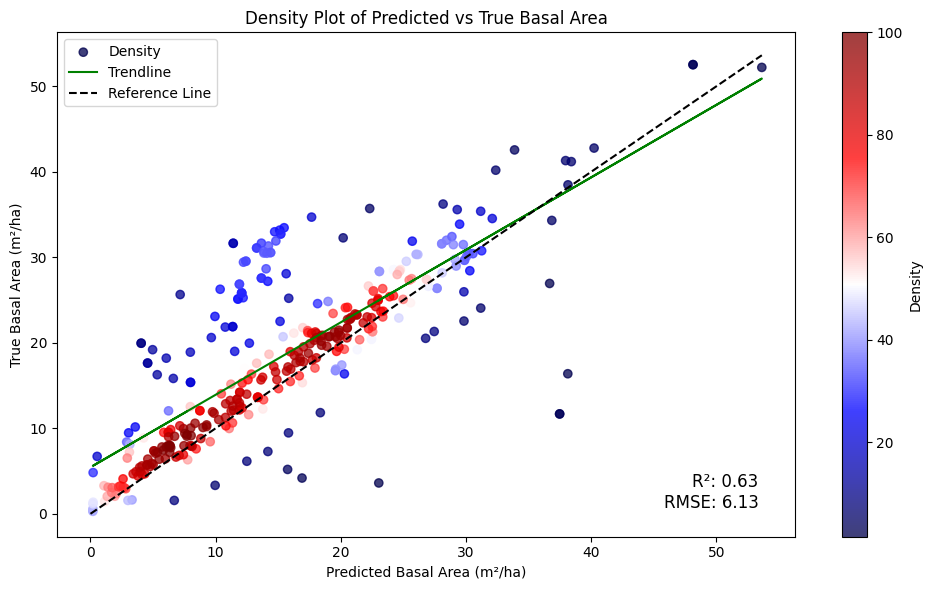

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


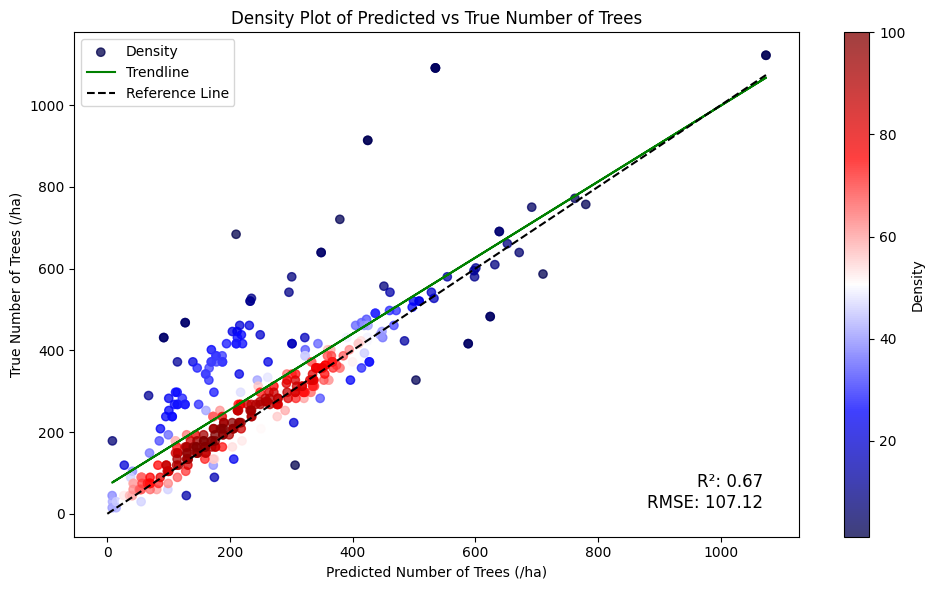

In [179]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from scipy.stats import gaussian_kde
import numpy as np

# Load data from CSV file
combined_data = pd.read_csv("all_predictions_REPORT1.csv")

# Basal Area (B)
# Rename columns for Basal Area
combined_data_b = combined_data.rename(columns={"trueB": "observed", "predB_mean": "prediction_B"})

# Calculate linear regression model and metrics for Basal Area
lm_b = LinearRegression().fit(combined_data_b["prediction_B"].values.reshape(-1, 1), combined_data_b["observed"])
rmse_b = mean_squared_error(combined_data_b["observed"], lm_b.predict(combined_data_b["prediction_B"].values.reshape(-1, 1)), squared=False)
r_squared_b = lm_b.score(combined_data_b["prediction_B"].values.reshape(-1, 1), combined_data_b["observed"])

# Create density plot with custom colors for Basal Area
plt.figure(figsize=(10, 6))
x_b = combined_data_b["prediction_B"]
y_b = combined_data_b["observed"]
xy_b = np.vstack([x_b, y_b])
z_b = gaussian_kde(xy_b)(xy_b)

# Sort the points by density for Basal Area
idx_b = z_b.argsort()
x_b, y_b, z_b = x_b[idx_b], y_b[idx_b], z_b[idx_b]

# Normalize density values to range from 0 to 100
z_b_normalized = z_b / np.max(z_b) * 100

# Scatter plot with normalized density colors for Basal Area using 'seismic' colormap
plt.scatter(x_b, y_b, c=z_b_normalized, cmap='seismic', alpha=0.75, label='Density')  # Using 'seismic' colormap for Basal Area
plt.colorbar(label='Density')

# Trendline for Basal Area
plt.plot(x_b, lm_b.predict(x_b.values.reshape(-1, 1)), color='green', linestyle='-', label='Trendline')

# Reference Line for Basal Area
plt.plot([0, x_b.max()], [0, x_b.max()], color='black', linestyle='--', label='Reference Line')

# Labels and title for Basal Area
plt.xlabel("Predicted Basal Area (m²/ha)")
plt.ylabel("True Basal Area (m²/ha)")
plt.title("Density Plot of Predicted vs True Basal Area")

# R-squared and RMSE text for Basal Area
plt.text(0.95, 0.05, f'R²: {r_squared_b:.2f}\nRMSE: {rmse_b:.2f}', transform=plt.gca().transAxes, ha='right', va='bottom', fontsize=12)

# Legend for Basal Area
plt.legend()

plt.tight_layout()
plt.show()

# Number of Trees (N)
# Rename columns for Number of Trees
combined_data_n = combined_data.rename(columns={"trueN": "observed", "predN_mean": "prediction_N"})

# Calculate linear regression model and metrics for Number of Trees
lm_n = LinearRegression().fit(combined_data_n["prediction_N"].values.reshape(-1, 1), combined_data_n["observed"])
rmse_n = mean_squared_error(combined_data_n["observed"], lm_n.predict(combined_data_n["prediction_N"].values.reshape(-1, 1)), squared=False)
r_squared_n = lm_n.score(combined_data_n["prediction_N"].values.reshape(-1, 1), combined_data_n["observed"])

# Create density plot with custom colors for Number of Trees
plt.figure(figsize=(10, 6))
x_n = combined_data_n["prediction_N"]
y_n = combined_data_n["observed"]
xy_n = np.vstack([x_n, y_n])
z_n = gaussian_kde(xy_n)(xy_n)

# Sort the points by density for Number of Trees
idx_n = z_n.argsort()
x_n, y_n, z_n = x_n[idx_n], y_n[idx_n], z_n[idx_n]

# Normalize density values to range from 0 to 100
z_n_normalized = z_n / np.max(z_n) * 100

# Scatter plot with normalized density colors for Number of Trees using 'seismic' colormap
plt.scatter(x_n, y_n, c=z_n_normalized, cmap='seismic', alpha=0.75, label='Density')  # Using 'seismic' colormap for Number of Trees
plt.colorbar(label='Density')

# Trendline for Number of Trees
plt.plot(x_n, lm_n.predict(x_n.values.reshape(-1, 1)), color='green', linestyle='-', label='Trendline')

# Reference Line for Number of Trees
plt.plot([0, x_n.max()], [0, x_n.max()], color='black', linestyle='--', label='Reference Line')

# Labels and title for Number of Trees
plt.xlabel("Predicted Number of Trees (/ha)")
plt.ylabel("True Number of Trees (/ha)")
plt.title("Density Plot of Predicted vs True Number of Trees")

# R-squared and RMSE text for Number of Trees
plt.text(0.95, 0.05, f'R²: {r_squared_n:.2f}\nRMSE: {rmse_n:.2f}', transform=plt.gca().transAxes, ha='right', va='bottom', fontsize=12)

# Legend for Number of Trees
plt.legend()

plt.tight_layout()
plt.show()


In [178]:
import pandas as pd

# Assuming 'all_predictions_REPORT1.csv' contains the data
combined_data = pd.read_csv("all_predictions_REPORT1.csv")

# Rename columns for Basal Area
combined_data_b = combined_data.rename(columns={"trueB": "observed", "predB_mean": "prediction_B"})

# Calculate the average of 'observed' and 'prediction_B' columns
average_observed = combined_data_b['observed'].mean()
average_prediction = combined_data_b['prediction_B'].mean()

print(f"Average Observed Basal Area (trueB): {average_observed}")
print(f"Average Predicted Basal Area (predB_mean): {average_prediction}")

# Calculate the average of 'observed' and 'prediction_B' columns
average_observed = combined_data_b['trueN'].mean()
average_prediction = combined_data_b['predN_mean'].mean()

print(f"Average Observed Number of Trees (trueB): {average_observed}")
print(f"Average Predicted Number of Trees : {average_prediction}")


Average Observed Basal Area (trueB): 18.59569161529101
Average Predicted Basal Area (predB_mean): 15.514478770501922
Average Observed Number of Trees (trueB): 304.41107933679785
Average Predicted Number of Trees : 253.14847311127485
